In [1]:
import pandas as pd 
import numpy as np 
import pandas_profiling

In [3]:
df = pd.read_csv('food_and_you_wave_5.csv')

/Users/mya03/dev/junk/venv3/lib/python3.7/site-packages/IPython/core/interactiveshell.py:3058: DtypeWarning: Columns (91) have mixed types. Specify dtype option on import or set low_memory=False.
  interactivity=interactivity, compiler=compiler, result=result)


In [4]:
df.head()

,serialno,age_dv,age_dv2,RespSex,marstat2,famtype,bhhsize,bhhsize2,below16,below6,...,Label,FdAuthAct_MC1,FdAuthAct_MC2,FdAuthAct_MC3,FdAuthAct_MC4,FdAuthAct_MC5,FdAuthAct_MC6,FdAuthAct_MC7,FdAuthAct_MC8,FdAuthAct_MC9
0,5110101,45-54,45-54,Female,Married/Civil Partnership/Living with Partner,"Married, with kids",Three,Three,Yes,No,...,Always,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,5110102,65-74,65-74,Male,Married/Civil Partnership/Living with Partner,"Married, no kids",Two,Two,No,No,...,Most of the time,Not mentioned,Not mentioned,Not mentioned,Not mentioned,Not mentioned,Not mentioned,Not mentioned,Not mentioned,Mentioned
2,5110104,45-54,45-54,Female,Married/Civil Partnership/Living with Partner,"Married, with kids",Four,Four or more,Yes,No,...,Most of the time,Not mentioned,Not mentioned,Not mentioned,Not mentioned,Not mentioned,Not mentioned,Not mentioned,Not mentioned,Mentioned
3,5110105,45-54,45-54,Female,Married/Civil Partnership/Living with Partner,"Married, no kids",Three,Three,No,No,...,Most of the time,Not mentioned,Not mentioned,Not mentioned,Not mentioned,Not mentioned,Not mentioned,Not mentioned,Not mentioned,Mentioned
4,5110106,55-64,55-64,Female,Married/Civil Partnership/Living with Partner,"Married, no kids",Two,Two,No,No,...,Most of the time,Not mentioned,Not mentioned,Not mentioned,Not mentioned,Not mentioned,Not mentioned,Not mentioned,Mentioned,Not mentioned


In [5]:
cols = ['Worried', 'FdLast', 'HealthyFd', 'SkipMeal', 'SkipOft', 'EatLess', 'Hungry', 'WtLoss', 'NotEat', 'NotEatOft', 'fdsecraw', 'fdsecstatus']

In [8]:
df = df[cols]

In [9]:
df

,Worried,FdLast,HealthyFd,SkipMeal,SkipOft,EatLess,Hungry,WtLoss,NotEat,NotEatOft,fdsecraw,fdsecstatus
0,Never true,Never true,Never true,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,High food security
1,Never true,Never true,Never true,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,High food security
2,Never true,Never true,Never true,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,High food security
3,Never true,Never true,Never true,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,High food security
4,Sometimes true,Sometimes true,Sometimes true,Yes,Almost every month,Yes,No,No,No,NaN,6,Low food security
...,...,...,...,...,...,...,...,...,...,...,...,...
3064,Never true,Never true,Never true,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,High food security
3065,Never true,Never true,Never true,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,High food security
3066,Never true,Never true,Never true,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,High food security
3067,Never true,Never true,Never true,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,High food security


In [10]:
df.profile_report(style={'full_width':True})

/Users/mya03/dev/junk/venv3/lib/python3.7/site-packages/pandas/core/frame.py:4223: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  return super().rename(**kwargs)
/Users/mya03/dev/junk/venv3/lib/python3.7/site-packages/pandas_profiling/model/correlations.py:34: RuntimeWarning: invalid value encountered in double_scalars
  return np.sqrt(phi2corr / min((kcorr - 1.0), (rcorr - 1.0)))


In [12]:
insecurity = pd.read_feather('insecurity.feather')

In [13]:
insecurity.profile_report(style={'full_width':True})

/Users/mya03/dev/junk/venv3/lib/python3.7/site-packages/pandas_profiling/model/correlations.py:34: RuntimeWarning: invalid value encountered in double_scalars
  return np.sqrt(phi2corr / min((kcorr - 1.0), (rcorr - 1.0)))


In [37]:
cols_keep = ['Worried', 'FdLast', 'HealthyFd', 'fdsecst', 'fdsecstatus']

In [46]:
cleaned = insecurity[cols_keep]
cleaned.shape

(3069, 16)

In [49]:
cleaned = cleaned.dropna()

In [56]:
cleaned = cleaned.drop('fdsecst', axis=1)

In [57]:
cleaned

,Worried,FdLast,HealthyFd,fdsecstatus,Q3_131,Q3_132,Q3_133,Q3_134,Q3_135,Q3_136,Q3_137,Q3_138,Q3_139,Q3_1310,Q3_1311
0,Never true,Never true,Never true,High food security,Not mentioned,Not mentioned,Not mentioned,Not mentioned,Not mentioned,Not mentioned,Not mentioned,Not mentioned,Not mentioned,Not mentioned,Not mentioned
1,Never true,Never true,Never true,High food security,Not mentioned,Not mentioned,Not mentioned,Not mentioned,Not mentioned,Not mentioned,Not mentioned,Not mentioned,Not mentioned,Not mentioned,Not mentioned
2,Never true,Never true,Never true,High food security,Not mentioned,Not mentioned,Mentioned,Not mentioned,Not mentioned,Mentioned,Mentioned,Mentioned,Not mentioned,Not mentioned,Not mentioned
3,Never true,Never true,Never true,High food security,Not mentioned,Not mentioned,Not mentioned,Not mentioned,Not mentioned,Not mentioned,Not mentioned,Not mentioned,Not mentioned,Not mentioned,Not mentioned
4,Sometimes true,Sometimes true,Sometimes true,Low food security,Mentioned,Mentioned,Not mentioned,Not mentioned,Not mentioned,Not mentioned,Not mentioned,Not mentioned,Not mentioned,Not mentioned,Not mentioned
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3064,Never true,Never true,Never true,High food security,Not mentioned,Not mentioned,Not mentioned,Not mentioned,Not mentioned,Not mentioned,Not mentioned,Not mentioned,Not mentioned,Not mentioned,Not mentioned
3065,Never true,Never true,Never true,High food security,Not mentioned,Not mentioned,Not mentioned,Not mentioned,Not mentioned,Not mentioned,Not mentioned,Not mentioned,Not mentioned,Not mentioned,Not mentioned
3066,Never true,Never true,Never true,High food security,Mentioned,Not mentioned,Not mentioned,Not mentioned,Not mentioned,Not mentioned,Not mentioned,Not mentioned,Not mentioned,Not mentioned,Not mentioned
3067,Never true,Never true,Never true,High food security,Not mentioned,Not mentioned,Not mentioned,Not mentioned,Not mentioned,Not mentioned,Not mentioned,Not mentioned,Not mentioned,Not mentioned,Not mentioned


In [76]:
y = cleaned.loc[:,['fdsecstatus']]
y

,fdsecstatus
0,High food security
1,High food security
2,High food security
3,High food security
4,Low food security
...,...
3064,High food security
3065,High food security
3066,High food security
3067,High food security


In [62]:
from sklearn.preprocessing import StandardScaler

In [66]:
X = pd.get_dummies(cleaned.drop('fdsecstatus', axis=1))
X

,Worried_Never true,Worried_Often true,Worried_Sometimes true,FdLast_Never true,FdLast_Often true,FdLast_Sometimes true,HealthyFd_Never true,HealthyFd_Often true,HealthyFd_Sometimes true,Q3_131_Mentioned,...,Q3_137_Mentioned,Q3_137_Not mentioned,Q3_138_Mentioned,Q3_138_Not mentioned,Q3_139_Mentioned,Q3_139_Not mentioned,Q3_1310_Mentioned,Q3_1310_Not mentioned,Q3_1311_Mentioned,Q3_1311_Not mentioned
0,1,0,0,1,0,0,1,0,0,0,...,0,1,0,1,0,1,0,1,0,1
1,1,0,0,1,0,0,1,0,0,0,...,0,1,0,1,0,1,0,1,0,1
2,1,0,0,1,0,0,1,0,0,0,...,1,0,1,0,0,1,0,1,0,1
3,1,0,0,1,0,0,1,0,0,0,...,0,1,0,1,0,1,0,1,0,1
4,0,0,1,0,0,1,0,0,1,1,...,0,1,0,1,0,1,0,1,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3064,1,0,0,1,0,0,1,0,0,0,...,0,1,0,1,0,1,0,1,0,1
3065,1,0,0,1,0,0,1,0,0,0,...,0,1,0,1,0,1,0,1,0,1
3066,1,0,0,1,0,0,1,0,0,1,...,0,1,0,1,0,1,0,1,0,1
3067,1,0,0,1,0,0,1,0,0,0,...,0,1,0,1,0,1,0,1,0,1


In [99]:
from sklearn.decomposition import PCA
pca = PCA(n_components=2)

principalComponents = pca.fit_transform(X)

In [100]:
principalDf = pd.DataFrame(data = principalComponents
             , columns = ['principal component 1', 'principal component 2'])

In [101]:
principalDf

,principal component 1,principal component 2
0,-0.767588,-0.069142
1,-0.767588,-0.069142
2,0.973569,-0.133774
3,-0.767588,-0.069142
4,0.945610,1.479878
...,...,...
3054,-0.767588,-0.069142
3055,-0.767588,-0.069142
3056,-0.253447,-0.342309
3057,-0.767588,-0.069142


array([['High food security'],
       ['High food security'],
       ['High food security'],
       ...,
       ['High food security'],
       ['High food security'],
       ['High food security']], dtype=object)

In [90]:
finalDf = pd.concat([principalDf, y], axis = 1)
finalDf

,principal component 1,principal component 2,fdsecstatus
0,-0.767588,-0.069142,High food security
1,-0.767588,-0.069142,High food security
2,0.973569,-0.133775,High food security
3,-0.767588,-0.069142,High food security
4,0.945610,1.479873,Low food security
...,...,...,...
3064,NaN,NaN,High food security
3065,NaN,NaN,High food security
3066,NaN,NaN,High food security
3067,NaN,NaN,High food security


In [87]:
import matplotlib.pyplot as plt

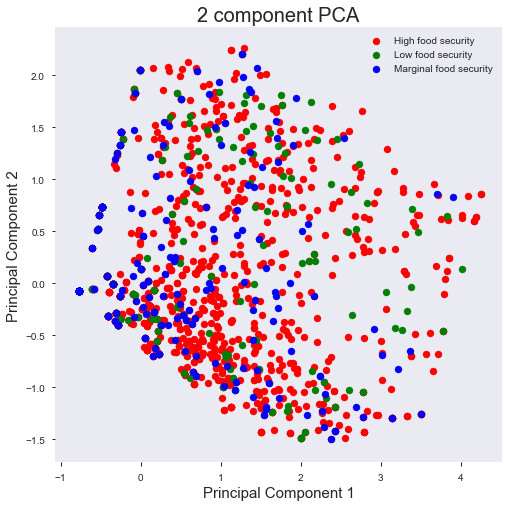

In [93]:
fig = plt.figure(figsize = (8,8))
ax = fig.add_subplot(1,1,1) 
ax.set_xlabel('Principal Component 1', fontsize = 15)
ax.set_ylabel('Principal Component 2', fontsize = 15)
ax.set_title('2 component PCA', fontsize = 20)
targets = ['High food security', 'Low food security', 'Marginal food security']
colors = ['r', 'g', 'b']
for target, color in zip(targets,colors):
    indicesToKeep = finalDf['fdsecstatus'] == target
    ax.scatter(finalDf.loc[indicesToKeep, 'principal component 1']
               , finalDf.loc[indicesToKeep, 'principal component 2']
               , c = color
               , s = 50)
ax.legend(targets)
ax.grid()

In [98]:
pca.components_

array([[-1.67394654e-01,  5.60303414e-02,  1.11364313e-01,
        -1.34644889e-01,  2.70715403e-02,  1.07573349e-01,
        -1.31215220e-01,  2.82081021e-02,  1.03007118e-01,
         2.57070321e-01, -2.57070321e-01,  2.21929026e-01,
        -2.21929026e-01,  2.30958028e-01, -2.30958028e-01,
         2.40530229e-01, -2.40530229e-01,  1.82249781e-01,
        -1.82249781e-01,  2.52950666e-01, -2.52950666e-01,
         2.11931090e-01, -2.11931090e-01,  1.74738856e-01,
        -1.74738856e-01,  1.84585236e-01, -1.84585236e-01,
         9.28245530e-02, -9.28245530e-02,  8.25851879e-02,
        -8.25851879e-02],
       [-4.61148618e-01,  1.21403609e-01,  3.39745008e-01,
        -3.94516180e-01,  6.61326360e-02,  3.28383544e-01,
        -3.36280806e-01,  7.75619294e-02,  2.58718876e-01,
        -1.36583537e-01,  1.36583537e-01, -1.48304115e-01,
         1.48304115e-01, -1.07793154e-01,  1.07793154e-01,
        -1.65908221e-01,  1.65908221e-01, -1.22092666e-01,
         1.22092666e-01, -2.72

In [94]:
pca.explained_variance_ratio_

array([0.35278048, 0.10851764])

In [106]:
pca.mean_

array([0.8296829 , 0.04380517, 0.12651193, 0.87904544, 0.0228833 ,
       0.09807127, 0.8836221 , 0.02615234, 0.09022556, 0.19516182,
       0.80483818, 0.14547238, 0.85452762, 0.1631252 , 0.8368748 ,
       0.170644  , 0.829356  , 0.139915  , 0.860085  , 0.20823799,
       0.79176201, 0.18175874, 0.81824126, 0.12683884, 0.87316116,
       0.12814645, 0.87185355, 0.06047728, 0.93952272, 0.06766917,
       0.93233083])

ValueError: too many values to unpack (expected 2)

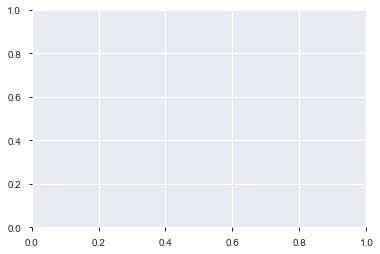

In [107]:
def draw_vector(v0, v1, ax=None):
    ax = ax or plt.gca()
    arrowprops=dict(arrowstyle='->',
                    linewidth=2,
                    shrinkA=0, shrinkB=0)
    ax.annotate('', v1, v0, arrowprops=arrowprops)

# plot data
# plt.scatter(X[:, 0], X[:, 1], alpha=0.2)
for length, vector in zip(pca.explained_variance_, pca.components_):
    v = vector * 3* np.sqrt(length)
    draw_vector(pca.mean_, pca.mean_ + v)
# plt.axis('equal');



In [95]:
pca = PCA(n_components=5)

principalComponents = pca.fit_transform(X)

In [96]:
pca.explained_variance_ratio_

array([0.35278048, 0.10851764, 0.07967147, 0.06042118, 0.05606719])

In [15]:
profile = insecurity.profile_report()

/Users/mya03/dev/junk/venv3/lib/python3.7/site-packages/pandas_profiling/model/correlations.py:34: RuntimeWarning: invalid value encountered in double_scalars
  return np.sqrt(phi2corr / min((kcorr - 1.0), (rcorr - 1.0)))


In [22]:
rejected_variables = profile.get_rejected_variables(threshold=0.01)

In [23]:
rejected_variables

[]

In [24]:
insecurity_safety = pd.read_feather('insecurity_safety.feather')

In [25]:
insecurity_safety.profile_report(style={'full_width':True})

In [28]:
insecurity.columns

Index(['Worried', 'FdLast', 'HealthyFd', 'SkipMeal', 'SkipOft', 'EatLess',
       'Hungry', 'WtLoss', 'NotEat', 'NotEatOft', 'fdsecst', 'fdsecstatus',
       'Q3_131', 'Q3_132', 'Q3_133', 'Q3_134', 'Q3_135', 'Q3_136', 'Q3_137',
       'Q3_138', 'Q3_139', 'Q3_1310', 'Q3_1311'],
      dtype='object')

In [113]:
rich = pd.read_feather('insecurity_rich.feather')

,RespSex,famtype,hqual,hhdinc,country_dv,age_dv2,Worried,FdLast,HealthyFd,fdsecstatus
0,Female,"Married, with kids",Degree qualification,None,England,45-54,Never true,Never true,Never true,High food security
1,Male,"Married, no kids",Degree qualification,"£26,000 - £51,999",England,65-74,Never true,Never true,Never true,High food security
2,Female,"Married, with kids",Other qualification,None,Wales,45-54,Never true,Never true,Never true,High food security
3,Female,"Married, no kids",Other qualification,None,Wales,45-54,Never true,Never true,Never true,High food security
4,Female,"Married, no kids",No qualifications,"£10,400 - £25,999",England,55-64,Sometimes true,Sometimes true,Sometimes true,Low food security
...,...,...,...,...,...,...,...,...,...,...
3064,Male,"Single, no kids",Degree qualification,"£26,000 - £51,999",England,55-64,Never true,Never true,Never true,High food security
3065,Female,"Married, no kids",Other qualification,None,England,75+,Never true,Never true,Never true,High food security
3066,Male,"Single, no kids",Other qualification,None,Wales,16-34,Never true,Never true,Never true,High food security
3067,Male,"Single, no kids",No qualifications,"£10,400 - £25,999",England,75+,Never true,Never true,Never true,High food security


In [115]:
from sklearn.model_selection import train_test_split

In [116]:
X = pd.get_dummies(rich.drop('fdsecstatus', axis=1))

In [119]:
y = rich.fdsecstatus

In [120]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.33, random_state=42)

In [123]:
from sklearn.tree import DecisionTreeClassifier 
from sklearn.metrics import confusion_matrix 

dtree_model = DecisionTreeClassifier(max_depth = 2).fit(X_train, y_train) 
dtree_predictions = dtree_model.predict(X_test) 

In [141]:
# creating a confusion matrix 
cm = confusion_matrix(y_test, dtree_predictions) 
confusion_matrix(y_test, dtree_predictions).ravel()

array([804,   2,   0,   1,  89,  23,   7,   6,  81])

In [145]:
from sklearn.utils.multiclass import unique_labels
def plot_confusion_matrix(y_true, y_pred, classes,
                          normalize=False,
                          title=None,
                          cmap=plt.cm.Blues):
    """
    This function prints and plots the confusion matrix.
    Normalization can be applied by setting `normalize=True`.
    """
    if not title:
        if normalize:
            title = 'Normalized confusion matrix'
        else:
            title = 'Confusion matrix, without normalization'

    # Compute confusion matrix
    cm = confusion_matrix(y_true, y_pred)
    # Only use the labels that appear in the data
    classes = classes[unique_labels(y_true, y_pred)]
    if normalize:
        cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]
        print("Normalized confusion matrix")
    else:
        print('Confusion matrix, without normalization')

    print(cm)

    fig, ax = plt.subplots()
    im = ax.imshow(cm, interpolation='nearest', cmap=cmap)
    ax.figure.colorbar(im, ax=ax)
    # We want to show all ticks...
    ax.set(xticks=np.arange(cm.shape[1]),
           yticks=np.arange(cm.shape[0]),
           # ... and label them with the respective list entries
           xticklabels=classes, yticklabels=classes,
           title=title,
           ylabel='True label',
           xlabel='Predicted label')

    # Rotate the tick labels and set their alignment.
    plt.setp(ax.get_xticklabels(), rotation=45, ha="right",
             rotation_mode="anchor")

    # Loop over data dimensions and create text annotations.
    fmt = '.2f' if normalize else 'd'
    thresh = cm.max() / 2.
    for i in range(cm.shape[0]):
        for j in range(cm.shape[1]):
            ax.text(j, i, format(cm[i, j], fmt),
                    ha="center", va="center",
                    color="white" if cm[i, j] > thresh else "black")
    fig.tight_layout()
    return ax


0

In [146]:
plot_confusion_matrix(y_test, dtree_predictions, classes=['a','b','c'])

TypeError: only integer scalar arrays can be converted to a scalar index

In [138]:
pd.DataFrame({'a': y_test, 'b': dtree_predictions})

,a,b
2651,High food security,High food security
1740,High food security,High food security
2606,High food security,High food security
1455,Low food security,Low food security
2164,High food security,High food security
...,...,...
611,High food security,High food security
530,High food security,High food security
1797,High food security,High food security
49,High food security,High food security


,RespSex_Female,RespSex_Male,"famtype_Married, no kids","famtype_Married, with kids","famtype_Single, no kids","famtype_Single, with kids",hqual_Degree qualification,hqual_No qualifications,hqual_Other qualification,"hhdinc_<£10,399",...,age_dv2_75+,Worried_Never true,Worried_Often true,Worried_Sometimes true,FdLast_Never true,FdLast_Often true,FdLast_Sometimes true,HealthyFd_Never true,HealthyFd_Often true,HealthyFd_Sometimes true
0,1,0,0,1,0,0,1,0,0,0,...,0,1,0,0,1,0,0,1,0,0
1,0,1,1,0,0,0,1,0,0,0,...,0,1,0,0,1,0,0,1,0,0
2,1,0,0,1,0,0,0,0,1,0,...,0,1,0,0,1,0,0,1,0,0
3,1,0,1,0,0,0,0,0,1,0,...,0,1,0,0,1,0,0,1,0,0
4,1,0,1,0,0,0,0,1,0,0,...,0,0,0,1,0,0,1,0,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3064,0,1,0,0,1,0,1,0,0,0,...,0,1,0,0,1,0,0,1,0,0
3065,1,0,1,0,0,0,0,0,1,0,...,1,1,0,0,1,0,0,1,0,0
3066,0,1,0,0,1,0,0,0,1,0,...,0,1,0,0,1,0,0,1,0,0
3067,0,1,0,0,1,0,0,1,0,0,...,1,1,0,0,1,0,0,1,0,0


In [128]:
z = pd.concat([X, y], axis = 1)

In [129]:
z.to_feather('dummied.feather')

,RespSex_Female,RespSex_Male,"famtype_Married, no kids","famtype_Married, with kids","famtype_Single, no kids","famtype_Single, with kids",hqual_Degree qualification,hqual_No qualifications,hqual_Other qualification,"hhdinc_<£10,399",...,Worried_Never true,Worried_Often true,Worried_Sometimes true,FdLast_Never true,FdLast_Often true,FdLast_Sometimes true,HealthyFd_Never true,HealthyFd_Often true,HealthyFd_Sometimes true,fdsecstatus
0,1,0,0,1,0,0,1,0,0,0,...,1,0,0,1,0,0,1,0,0,High food security
1,0,1,1,0,0,0,1,0,0,0,...,1,0,0,1,0,0,1,0,0,High food security
2,1,0,0,1,0,0,0,0,1,0,...,1,0,0,1,0,0,1,0,0,High food security
3,1,0,1,0,0,0,0,0,1,0,...,1,0,0,1,0,0,1,0,0,High food security
4,1,0,1,0,0,0,0,1,0,0,...,0,0,1,0,0,1,0,0,1,Low food security
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3064,0,1,0,0,1,0,1,0,0,0,...,1,0,0,1,0,0,1,0,0,High food security
3065,1,0,1,0,0,0,0,0,1,0,...,1,0,0,1,0,0,1,0,0,High food security
3066,0,1,0,0,1,0,0,0,1,0,...,1,0,0,1,0,0,1,0,0,High food security
3067,0,1,0,0,1,0,0,1,0,0,...,1,0,0,1,0,0,1,0,0,High food security


In [155]:
from sklearn.decomposition import PCA
pca = PCA(n_components=2)

principalComponents = pca.fit_transform(X)

principalDf = pd.DataFrame(data = principalComponents
             , columns = ['principal component 1', 'principal component 2'])

In [156]:
finalDf = pd.concat([principalDf, y], axis = 1)
finalDf

,principal component 1,principal component 2,fdsecstatus
0,-0.001825,-0.926332,High food security
1,-1.301700,0.031403,High food security
2,0.321699,-0.545414,High food security
3,0.002261,-0.675431,High food security
4,1.607898,0.334916,Low food security
...,...,...,...
3064,-0.814703,0.467802,High food security
3065,-0.067985,-0.627616,High food security
3066,-0.270211,0.935703,High food security
3067,-0.308324,0.850774,High food security


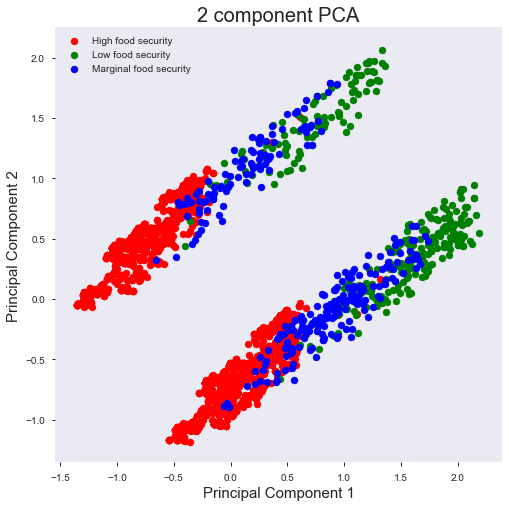

In [157]:
fig = plt.figure(figsize = (8,8))
ax = fig.add_subplot(1,1,1) 
ax.set_xlabel('Principal Component 1', fontsize = 15)
ax.set_ylabel('Principal Component 2', fontsize = 15)
ax.set_title('2 component PCA', fontsize = 20)
targets = ['High food security', 'Low food security', 'Marginal food security']
colors = ['r', 'g', 'b']
for target, color in zip(targets,colors):
    indicesToKeep = finalDf['fdsecstatus'] == target
    ax.scatter(finalDf.loc[indicesToKeep, 'principal component 1']
               , finalDf.loc[indicesToKeep, 'principal component 2']
               , c = color
               , s = 50)
ax.legend(targets)
ax.grid()

In [160]:
rich.columns

Index(['RespSex', 'famtype', 'hqual', 'hhdinc', 'country_dv', 'age_dv2',
       'Worried', 'FdLast', 'HealthyFd', 'fdsecstatus'],
      dtype='object')

In [194]:
keep = ['RespSex', 'famtype', 'hqual', 'hhdinc', 'age_dv2','Worried', 'fdsecstatus']

In [195]:
rch = rich[keep]

In [196]:
X = pd.get_dummies(rch.drop('fdsecstatus', axis=1))
y = rch.fdsecstatus

In [197]:
pca = PCA(n_components=2)

principalComponents = pca.fit_transform(X)

principalDf = pd.DataFrame(data = principalComponents
             , columns = ['principal component 1', 'principal component 2'])

In [198]:
finalDf = pd.concat([principalDf, y], axis = 1)
finalDf

,principal component 1,principal component 2,fdsecstatus
0,-0.465881,-0.925702,High food security
1,1.194959,-0.764251,High food security
2,-0.580282,-0.217941,High food security
3,-0.345006,-0.446995,High food security
4,-0.677518,-0.077774,Low food security
...,...,...,...
3064,0.871858,0.146376,High food security
3065,-0.364400,-0.253953,High food security
3066,0.601438,1.006938,High food security
3067,0.511167,1.107828,High food security


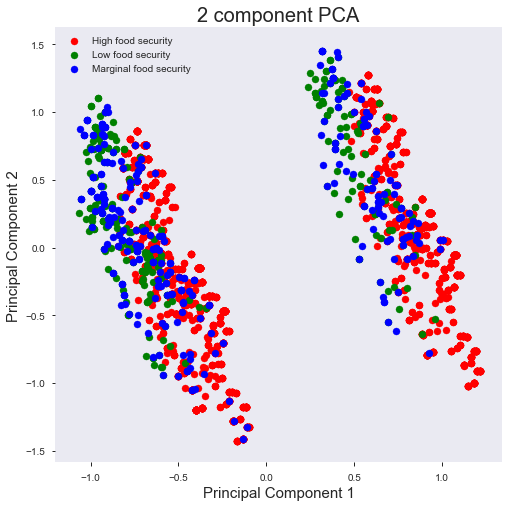

In [199]:
fig = plt.figure(figsize = (8,8))
ax = fig.add_subplot(1,1,1) 
ax.set_xlabel('Principal Component 1', fontsize = 15)
ax.set_ylabel('Principal Component 2', fontsize = 15)
ax.set_title('2 component PCA', fontsize = 20)
targets = ['High food security', 'Low food security', 'Marginal food security']
colors = ['r', 'g', 'b']
for target, color in zip(targets,colors):
    indicesToKeep = finalDf['fdsecstatus'] == target
    ax.scatter(finalDf.loc[indicesToKeep, 'principal component 1']
               , finalDf.loc[indicesToKeep, 'principal component 2']
               , c = color
               , s = 50)
ax.legend(targets)
ax.grid()

In [175]:
pca.explained_variance_ratio_

array([0.12599567, 0.10720195])

In [217]:
# Investigate the variance accounted for by each principal component.
def scree_plot(pca):
    
    num_components = len(pca.explained_variance_ratio_)
    ind = np.arange(num_components)
    vals = pca.explained_variance_ratio_
 
    plt.figure(figsize=(10, 6))
    ax = plt.subplot(111)
    cumvals = np.cumsum(vals)
    ax.bar(ind, vals)
    ax.plot(ind, cumvals)
    
    ax.xaxis.set_tick_params(width=0)
    ax.yaxis.set_tick_params(width=2, length=10)
 
    ax.set_xlabel("Principal Component")
    ax.set_ylabel("Variance(%)")
    plt.title('Variance')

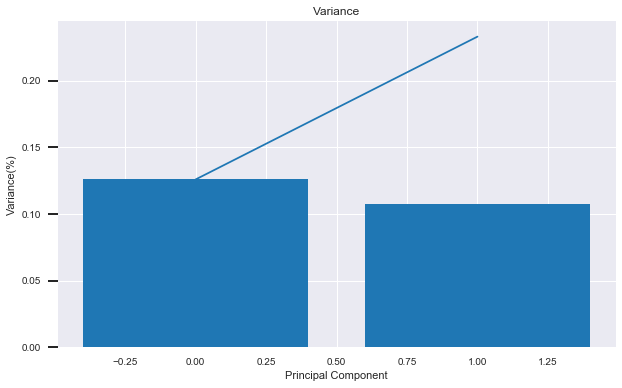

In [182]:
scree_plot(pca)

In [216]:
import operator

def pca_weights(pca, i):
    weight_map = {}
    for counter, feature in enumerate(df.columns):
        weight_map[feature] = pca.components_[i][counter]
    
    sorted_weights = sorted(weight_map.items(), key=operator.itemgetter(1), reverse=True)
    
    return sorted_weights

In [188]:
pca_weights(pca,0)

([('FdLast', 0.6525636979870388),
  ('HealthyFd', 0.20724952076822648),
  ('Hungry', 0.10851170561934526),
  ('fdsecraw', 0.10601165184468968),
  ('SkipMeal', -0.018682613213139222),
  ('NotEat', -0.022326226488010834),
  ('fdsecstatus', -0.07103191110790139),
  ('NotEatOft', -0.07849525878424413),
  ('WtLoss', -0.0872151813099359),
  ('EatLess', -0.08784803249993493),
  ('SkipOft', -0.10174476723324832),
  ('Worried', -0.6525636979870387)],
 [('SkipOft', 0.5047138911684397),
  ('NotEat', 0.2772092774038518),
  ('fdsecstatus', 0.21888362106087633),
  ('FdLast', 0.21351026307413074),
  ('WtLoss', 0.14411354048125394),
  ('NotEatOft', 0.09644858190796808),
  ('EatLess', 0.00614893188934698),
  ('SkipMeal', -0.17968356520081785),
  ('Worried', -0.21351026307413087),
  ('fdsecraw', -0.26125848255485684),
  ('HealthyFd', -0.3277923742579087),
  ('Hungry', -0.4240401764532739)])

In [189]:
pca_weights(pca,1)

[('SkipOft', 0.5047138911684397),
 ('NotEat', 0.2772092774038518),
 ('fdsecstatus', 0.21888362106087633),
 ('FdLast', 0.21351026307413074),
 ('WtLoss', 0.14411354048125394),
 ('NotEatOft', 0.09644858190796808),
 ('EatLess', 0.00614893188934698),
 ('SkipMeal', -0.17968356520081785),
 ('Worried', -0.21351026307413087),
 ('fdsecraw', -0.26125848255485684),
 ('HealthyFd', -0.3277923742579087),
 ('Hungry', -0.4240401764532739)]

In [200]:
rich

,RespSex,famtype,hqual,hhdinc,country_dv,age_dv2,Worried,FdLast,HealthyFd,fdsecstatus
0,Female,"Married, with kids",Degree qualification,None,England,45-54,Never true,Never true,Never true,High food security
1,Male,"Married, no kids",Degree qualification,"£26,000 - £51,999",England,65-74,Never true,Never true,Never true,High food security
2,Female,"Married, with kids",Other qualification,None,Wales,45-54,Never true,Never true,Never true,High food security
3,Female,"Married, no kids",Other qualification,None,Wales,45-54,Never true,Never true,Never true,High food security
4,Female,"Married, no kids",No qualifications,"£10,400 - £25,999",England,55-64,Sometimes true,Sometimes true,Sometimes true,Low food security
...,...,...,...,...,...,...,...,...,...,...
3064,Male,"Single, no kids",Degree qualification,"£26,000 - £51,999",England,55-64,Never true,Never true,Never true,High food security
3065,Female,"Married, no kids",Other qualification,None,England,75+,Never true,Never true,Never true,High food security
3066,Male,"Single, no kids",Other qualification,None,Wales,16-34,Never true,Never true,Never true,High food security
3067,Male,"Single, no kids",No qualifications,"£10,400 - £25,999",England,75+,Never true,Never true,Never true,High food security


In [201]:
rich.columns

Index(['RespSex', 'famtype', 'hqual', 'hhdinc', 'country_dv', 'age_dv2',
       'Worried', 'FdLast', 'HealthyFd', 'fdsecstatus'],
      dtype='object')

In [212]:
X = pd.get_dummies(rich.drop(['fdsecstatus', 'country_dv'], axis=1))
y = rich.fdsecstatus

In [213]:
X.columns

Index(['RespSex_Female', 'RespSex_Male', 'famtype_Married, no kids',
       'famtype_Married, with kids', 'famtype_Single, no kids',
       'famtype_Single, with kids', 'hqual_Degree qualification',
       'hqual_No qualifications', 'hqual_Other qualification',
       'hhdinc_<£10,399', 'hhdinc_>£52,000', 'hhdinc_£10,400 - £25,999',
       'hhdinc_£26,000 - £51,999', 'age_dv2_16-34', 'age_dv2_35-44',
       'age_dv2_45-54', 'age_dv2_55-64', 'age_dv2_65-74', 'age_dv2_75+',
       'Worried_Never true', 'Worried_Often true', 'Worried_Sometimes true',
       'FdLast_Never true', 'FdLast_Often true', 'FdLast_Sometimes true',
       'HealthyFd_Never true', 'HealthyFd_Often true',
       'HealthyFd_Sometimes true'],
      dtype='object')

In [214]:
pca = PCA(n_components=2)

principalComponents = pca.fit_transform(X)

principalDf = pd.DataFrame(data = principalComponents
             , columns = ['principal component 1', 'principal component 2'])
finalDf = pd.concat([principalDf, y], axis = 1)
finalDf

,principal component 1,principal component 2,fdsecstatus
0,0.015580,-0.926706,High food security
1,-1.287719,0.035658,High food security
2,0.270503,-0.530021,High food security
3,-0.053824,-0.658651,High food security
4,1.621919,0.328993,Low food security
...,...,...,...
3064,-0.797298,0.468474,High food security
3065,-0.062905,-0.622291,High food security
3066,-0.319516,0.951000,High food security
3067,-0.299609,0.849512,High food security


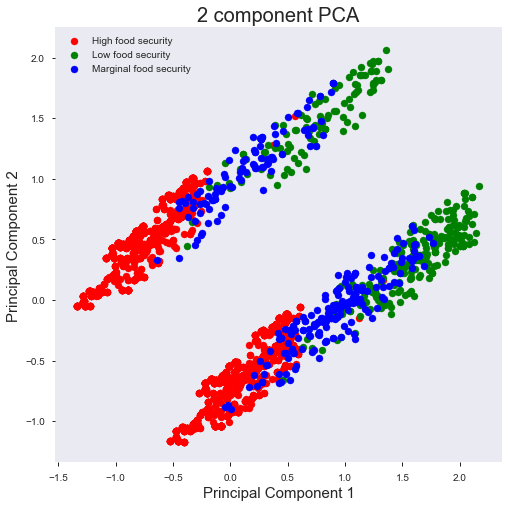

In [215]:
fig = plt.figure(figsize = (8,8))
ax = fig.add_subplot(1,1,1) 
ax.set_xlabel('Principal Component 1', fontsize = 15)
ax.set_ylabel('Principal Component 2', fontsize = 15)
ax.set_title('2 component PCA', fontsize = 20)
targets = ['High food security', 'Low food security', 'Marginal food security']
colors = ['r', 'g', 'b']
for target, color in zip(targets,colors):
    indicesToKeep = finalDf['fdsecstatus'] == target
    ax.scatter(finalDf.loc[indicesToKeep, 'principal component 1']
               , finalDf.loc[indicesToKeep, 'principal component 2']
               , c = color
               , s = 50)
ax.legend(targets)
ax.grid()

In [218]:
pca_weights(pca,0)

[('Worried', 0.4066361455256948),
 ('SkipOft', 0.14931896492123983),
 ('fdsecstatus', 0.11662188437121433),
 ('EatLess', 0.10334379142596264),
 ('NotEatOft', 0.10062150176962141),
 ('WtLoss', 0.09985341407990464),
 ('NotEat', 0.07712537036390425),
 ('SkipMeal', 0.036428439633850146),
 ('fdsecraw', -0.14590477195663756),
 ('Hungry', -0.17779813827624996),
 ('HealthyFd', -0.28790053752285),
 ('FdLast', -0.4066361455256951)]

In [219]:
pca_weights(pca,1)

[('FdLast', 0.5594628686174933),
 ('SkipOft', 0.22600127738719564),
 ('NotEat', 0.18325095834989166),
 ('fdsecstatus', 0.11060054085837148),
 ('NotEatOft', 0.03306200952947449),
 ('WtLoss', 0.027067850641759584),
 ('EatLess', -0.008288559332066457),
 ('SkipMeal', -0.04382616038138904),
 ('fdsecraw', -0.11178372192893167),
 ('HealthyFd', -0.17244893840370124),
 ('Hungry', -0.21343388891342813),
 ('Worried', -0.5594628686174932)]